In [0]:
import numpy as np
import time
import sys
import os
import random
from skimage import io
import pandas as pd
from matplotlib import pyplot as plt
from shutil import copyfile
from glob import glob
import scipy.misc
import cv2
import tensorflow as tf
import keras

from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
from sklearn.model_selection import train_test_split

import keras.models as models

from keras.models import Sequential, Model
from keras.layers.core import Dense, Dropout, Activation, Flatten, Reshape
from keras.layers import BatchNormalization,Input
from keras.layers.recurrent import SimpleRNN, LSTM
from keras.layers.convolutional import Convolution2D
from keras.optimizers import SGD, Adam, RMSprop
import sklearn.metrics as metrics

from keras.callbacks import ModelCheckpoint


In [0]:
from sklearn import preprocessing
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import shutil
import os
import requests
import base64


# Encode text values to dummy variables(i.e. [1,0,0],[0,1,0],[0,0,1] for red,green,blue)
def encode_text_dummy(df, name):
    dummies = pd.get_dummies(df[name])
    for x in dummies.columns:
        dummy_name = "{}-{}".format(name, x)
        df[dummy_name] = dummies[x]
    df.drop(name, axis=1, inplace=True)


# Encode text values to a single dummy variable.  The new columns (which do not replace the old) will have a 1
# at every location where the original column (name) matches each of the target_values.  One column is added for
# each target value.
def encode_text_single_dummy(df, name, target_values):
    for tv in target_values:
        l = list(df[name].astype(str))
        l = [1 if str(x) == str(tv) else 0 for x in l]
        name2 = "{}-{}".format(name, tv)
        df[name2] = l


# Encode text values to indexes(i.e. [1],[2],[3] for red,green,blue).
def encode_text_index(df, name):
    le = preprocessing.LabelEncoder()
    df[name] = le.fit_transform(df[name])
    return le.classes_


# Encode a numeric column as zscores
def encode_numeric_zscore(df, name, mean=None, sd=None):
    if mean is None:
        mean = df[name].mean()

    if sd is None:
        sd = df[name].std()

    df[name] = (df[name] - mean) / sd


# Convert all missing values in the specified column to the median
def missing_median(df, name):
    med = df[name].median()
    df[name] = df[name].fillna(med)


# Convert all missing values in the specified column to the default
def missing_default(df, name, default_value):
    df[name] = df[name].fillna(default_value)


# Convert a Pandas dataframe to the x,y inputs that TensorFlow needs
def to_xy(df, target):
    result = []
    for x in df.columns:
        if x != target:
            result.append(x)
    # find out the type of the target column.  Is it really this hard? :(
    target_type = df[target].dtypes
    target_type = target_type[0] if hasattr(target_type, '__iter__') else target_type
    # Encode to int for classification, float otherwise. TensorFlow likes 32 bits.
    if target_type in (np.int64, np.int32):
        # Classification
        dummies = pd.get_dummies(df[target])
        return df.as_matrix(result).astype(np.float32), dummies.as_matrix().astype(np.float32)
    else:
        # Regression
        return df.as_matrix(result).astype(np.float32), df.as_matrix([target]).astype(np.float32)

# Nicely formatted time string
def hms_string(sec_elapsed):
    h = int(sec_elapsed / (60 * 60))
    m = int((sec_elapsed % (60 * 60)) / 60)
    s = sec_elapsed % 60
    return "{}:{:>02}:{:>05.2f}".format(h, m, s)


# Regression chart.
def chart_regression(pred,y,sort=True):
    t = pd.DataFrame({'pred' : pred, 'y' : y.flatten()})
    if sort:
        t.sort_values(by=['y'],inplace=True)
    a = plt.plot(t['y'].tolist(),label='expected')
    b = plt.plot(t['pred'].tolist(),label='prediction')
    plt.ylabel('output')
    plt.legend()
    plt.show()

# Remove all rows where the specified column is +/- sd standard deviations
def remove_outliers(df, name, sd):
    drop_rows = df.index[(np.abs(df[name] - df[name].mean()) >= (sd * df[name].std()))]
    df.drop(drop_rows, axis=0, inplace=True)


# Encode a column to a range between normalized_low and normalized_high.
def encode_numeric_range(df, name, normalized_low=-1, normalized_high=1,
                         data_low=None, data_high=None):
    if data_low is None:
        data_low = min(df[name])
        data_high = max(df[name])

    df[name] = ((df[name] - data_low) / (data_high - data_low)) \
               * (normalized_high - normalized_low) + normalized_low
        

In [0]:
#to modify csv
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
complete_steering_df = pd.read_csv('/content/gdrive/My Drive/datasets/steering_angle_project/steering.csv')
time_steer_df = complete_steering_df[['%time', 'field.steering_wheel_angle']].copy()
print(time_steer_df.shape)


(37976, 2)


In [0]:
base_path='/content/gdrive/My Drive/datasets/steering_angle_project/'


In [0]:
image_paths = glob(os.path.join(base_path, 'center_frames','*.jpg'))
image_paths=sorted(image_paths)
image_paths

['/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00000.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00001.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00002.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00003.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00004.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00005.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00006.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00007.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00008.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00009.jpg',
 '/content/gdrive/My Drive/datasets/steering_angle_project/center_frames/frame00010.jpg',
 '/content

In [0]:

# all_imgs_int=[]

# image_paths = glob(os.path.join(base_path, 'center_frames','*.jpg'))
# image_paths=sorted(image_paths)

# m=int(480/20)
# n=int(640/10)
# k=0

# for image in image_paths:
  
#   img= scipy.misc.imread(image,mode='L')
#   crop_img = img[240:480, 0:640]
#   resized_img = cv2.resize(crop_img, (n,m), interpolation=cv2.INTER_AREA) 
#   vec=resized_img.flatten()
#   all_imgs_int.append(vec)
#   k=k+1
#   if(k%500==0):
#     print(k)


In [0]:

# import pandas as pd
# center_images_df=pd.DataFrame(all_imgs_int)
# center_images_df



In [0]:
# filename_write = os.path.join(base_path,'center_images_df.csv')

# center_images_df.to_csv(filename_write,index=False)

In [0]:
# all_imgs_cnn=[]


# k=0

# for image in image_paths:
  
#   img= scipy.misc.imread(image,mode='L')
#   crop_img = img[240:480, 0:640]
#   resized_img = cv2.resize(crop_img, (n,m), interpolation=cv2.INTER_AREA) 
#   #vec=resized_img.flatten()
#   all_imgs_cnn.append(resized_img)
#   k=k+1
#   if(k%500==0):
#     print(k)
    
# print(np.shape(all_imgs_cnn))

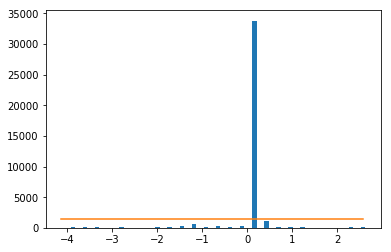

In [0]:
#filtering steering angle values afterremoving most zeros



no_bins=25
max_bin=1500
hist,bins=np.histogram(time_steer_df['field.steering_wheel_angle'],no_bins)

plt.bar(bins[1:],hist,width=0.1)
plt.plot((np.min(time_steer_df['field.steering_wheel_angle'])),(np.max(time_steer_df['field.steering_wheel_angle'])))
plt.plot((np.min(time_steer_df['field.steering_wheel_angle']),np.max(time_steer_df['field.steering_wheel_angle'])),(max_bin,max_bin))
# plt.plot((0,1000),(4,1000))


In [0]:
print(hist)
print(bins)
print(len(image_paths))

[  161    99    55    44    54    42    47    69   142   285   626   153
   330   135   263 33810  1137   165    81    56    28    26    44    50
    74]
[-4.14515686 -3.87644597 -3.60773508 -3.33902419 -3.0703133  -2.80160241
 -2.53289152 -2.26418063 -1.99546974 -1.72675885 -1.45804796 -1.18933707
 -0.92062618 -0.65191529 -0.3832044  -0.11449351  0.15421738  0.42292827
  0.69163916  0.96035005  1.22906094  1.49777183  1.76648272  2.03519361
  2.3039045   2.57261539]
15025


37976
5976
32000
(5976, 2)


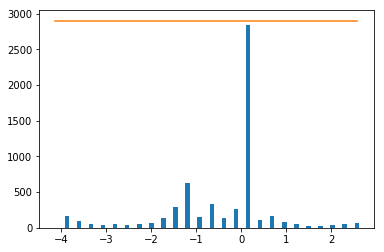

In [0]:
steering_arr=time_steer_df.values


#print(steering_arr)
np.random.shuffle(steering_arr)
#print(steering_arr)
#print(np.shape(steering_arr))
print(len(steering_arr))
#print(steering_arr[1][1])
j=0
steering_filtered=[]

for i in range(0,len(steering_arr)):
  if(steering_arr[i][1]>=-0.11 and steering_arr[i][1]<0.422 and j<32000):
    j=j+1
  else:
    steering_filtered.append(steering_arr[i])
      
print(len(steering_filtered))

print(j)
print(np.shape(steering_filtered))

time_steer_filtered_df=pd.DataFrame(steering_filtered)

time_steer_filtered_df= time_steer_filtered_df.sort_values(by=0,ascending=True)
time_steer_filtered_df.columns=['time','steering_angle']

no_bins_c=25
max_bin_c=2900

hist1,bins1=np.histogram(time_steer_filtered_df['steering_angle'],no_bins_c)

plt.bar(bins1[1:],hist1,width=0.1)
plt.plot((np.min(time_steer_filtered_df['steering_angle'])),(np.max(time_steer_filtered_df['steering_angle'])))
plt.plot((np.min(time_steer_filtered_df['steering_angle']),np.max(time_steer_filtered_df['steering_angle'])),(max_bin_c,max_bin_c))


In [0]:
filename_write = os.path.join(base_path,'filtered_steering.csv')

time_steer_filtered_df.to_csv(filename_write,index=False)

In [0]:
image_name=[]
image_time=[]


deltaT=760/len(image_paths)
curr_tim=0

for image in image_paths:
  image_name.append(os.path.basename(image))
  image_time.append(curr_tim)
  curr_tim=curr_tim+deltaT
  
image_data = {'image_name':image_name, 'image_time':image_time}
image_imagetime_df=pd.DataFrame(image_data)





In [0]:
steer_time=[]
start_time= time_steer_df.iloc[0][0]

for i in range(0,len(time_steer_filtered_df)):
  steer_time.append((time_steer_filtered_df.iloc[i][0]-start_time)/1e+9)
  
  
time_steer_filtered_df['steer_time']=steer_time


In [0]:

#image_imagetime_df
print(np.max(time_steer_filtered_df['steering_angle']))
print(np.min(time_steer_filtered_df['steering_angle']))
time_steer_filtered_df

2.5726153850599998
-4.14515686035


,time,steering_angle,steer_time
4799,1.475187e+18,-0.020944,0.601011
4984,1.475187e+18,-0.006981,0.701125
4347,1.475187e+18,-0.005236,0.821373
4706,1.475187e+18,-0.013963,1.161862
5689,1.475187e+18,-0.015708,1.202026
4437,1.475187e+18,-0.017453,1.302215
5841,1.475187e+18,-0.017453,1.322475
3970,1.475187e+18,-0.019199,1.402265
5339,1.475187e+18,-0.019199,1.422316
5955,1.475187e+18,-0.020944,1.462430


In [0]:
image_imagetime_df['steering_ang']=20.000000000000000000000
image_imagetime_df

,image_name,image_time,steering_ang
0,frame00000.jpg,0.000000,20.0
1,frame00001.jpg,0.050582,20.0
2,frame00002.jpg,0.101165,20.0
3,frame00003.jpg,0.151747,20.0
4,frame00004.jpg,0.202329,20.0
5,frame00005.jpg,0.252912,20.0
6,frame00006.jpg,0.303494,20.0
7,frame00007.jpg,0.354077,20.0
8,frame00008.jpg,0.404659,20.0
9,frame00009.jpg,0.455241,20.0


In [0]:
print(image_imagetime_df.iloc[1][1])
print(time_steer_filtered_df.iloc[1000][1])

0.05058236272878536
0.045378562063


In [0]:
break_point=0
  


for i in range(0,len(time_steer_filtered_df)):
  print('i: ',i)
  flag=0
  for j in range(break_point,len(image_imagetime_df)):
    print('i: ',i, 'j: ', j)
    if abs(time_steer_filtered_df.iloc[i][2]-image_imagetime_df.iloc[j][1])<0.1:
      flag=1
      print('inside if statement')
      image_imagetime_df['steering_ang'][j]=time_steer_filtered_df.iloc[i][1]
      break_point=j
      break
      
      
  if(flag==0):
    print('flag is 0')
    image_imagetime_df['steering_ang'][break_point+1]=time_steer_filtered_df.iloc[i][1]
    break_point=break_point+1
    
    
image_imagetime_df

i:  0
i:  0 j:  0
i:  0 j:  1
i:  0 j:  2
i:  0 j:  3
i:  0 j:  4
i:  0 j:  5
i:  0 j:  6
i:  0 j:  7
i:  0 j:  8
i:  0 j:  9
i:  0 j:  10
inside if statement
i:  1
i:  1 j:  10
i:  1 j:  11
i:  1 j:  12
inside if statement
i:  2
i:  2 j:  12
i:  2 j:  13
i:  2 j:  14
i:  2 j:  15
inside if statement


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]


i:  3
i:  3 j:  15
i:  3 j:  16
i:  3 j:  17
i:  3 j:  18
i:  3 j:  19
i:  3 j:  20
i:  3 j:  21
inside if statement
i:  4
i:  4 j:  21
i:  4 j:  22
inside if statement
i:  5
i:  5 j:  22
i:  5 j:  23
i:  5 j:  24
inside if statement
i:  6
i:  6 j:  24
i:  6 j:  25
inside if statement
i:  7
i:  7 j:  25
i:  7 j:  26
inside if statement
i:  8
i:  8 j:  26
i:  8 j:  27
inside if statement
i:  9
i:  9 j:  27
inside if statement
i:  10
i:  10 j:  27
i:  10 j:  28
i:  10 j:  29
i:  10 j:  30
i:  10 j:  31
inside if statement
i:  11
i:  11 j:  31
i:  11 j:  32
i:  11 j:  33
i:  11 j:  34
i:  11 j:  35
i:  11 j:  36
i:  11 j:  37
i:  11 j:  38
i:  11 j:  39
inside if statement
i:  12
i:  12 j:  39
i:  12 j:  40
i:  12 j:  41
i:  12 j:  42
i:  12 j:  43
inside if statement
i:  13
i:  13 j:  43
i:  13 j:  44
i:  13 j:  45
i:  13 j:  46
i:  13 j:  47
i:  13 j:  48
inside if statement
i:  14
i:  14 j:  48
i:  14 j:  49
i:  14 j:  50
inside if statement
i:  15
i:  15 j:  50
i:  15 j:  51
i:  15 j:

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


,image_name,image_time,steering_ang
0,frame00000.jpg,0.000000,20.000000
1,frame00001.jpg,0.050582,20.000000
2,frame00002.jpg,0.101165,20.000000
3,frame00003.jpg,0.151747,20.000000
4,frame00004.jpg,0.202329,20.000000
5,frame00005.jpg,0.252912,20.000000
6,frame00006.jpg,0.303494,20.000000
7,frame00007.jpg,0.354077,20.000000
8,frame00008.jpg,0.404659,20.000000
9,frame00009.jpg,0.455241,-0.020944


In [0]:
alldf=image_imagetime_df[image_imagetime_df['steering_ang']!=20.000000]
alldf=alldf[alldf['steering_ang']<19]
#alldf=alldf.drop('image_tim',1)
alldf

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,image_name,image_time,steering_ang
9,frame00009.jpg,0.455241,-0.020944
10,frame00010.jpg,0.505824,-0.020944
11,frame00011.jpg,0.556406,-0.006981
12,frame00012.jpg,0.606988,-0.006981
14,frame00014.jpg,0.708153,-0.005236
15,frame00015.jpg,0.758735,-0.005236
21,frame00021.jpg,1.062230,-0.013963
22,frame00022.jpg,1.112812,-0.015708
23,frame00023.jpg,1.163394,-0.017453
24,frame00024.jpg,1.213977,-0.017453


In [0]:
filename_write = os.path.join(base_path,'image_time_steering.csv')

image_imagetime_df.to_csv(filename_write,index=False)

In [0]:
print(np.max(alldf['steering_ang']))

2.5726153850599998


In [0]:
m=66
n=200

In [0]:
all_imgs_cnn=[]
steering_ang=[]

k=0

for i in range(0,len(alldf)):
  image_name=os.path.join(base_path, 'center_frames', alldf.iloc[i][0])
  img= scipy.misc.imread(image_name)
  crop_img = img[240:480, 0:640]
  resized_img = cv2.resize(crop_img, (n,m), interpolation=cv2.INTER_AREA)
  all_imgs_cnn.append(resized_img)
  steering_ang.append(alldf.iloc[i][2])
  
  k=k+1
  if(k%500==0):
    print(k)
    
print(np.shape(all_imgs_cnn))  

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  


500
1000
1500
2000
2500
3000
3500
4000
4500
5000
5500
6000
(6160, 66, 200, 3)


In [0]:
nrows = 66
ncols = 200
print(np.min(steering_ang))

-4.14515686035


In [0]:
# Split into train/test
x_train, x_test, y_train, y_test = train_test_split(    
    all_imgs_cnn, steering_ang, test_size=0.2, random_state=42, shuffle= True) 


In [0]:
x_train = np.asarray(x_train)
y_train = np.asarray(y_train)
x_test = np.asarray(x_test)
y_test = np.asarray(y_test)


x_train = x_train.astype('float32')
x_test = x_test.astype('float32')

x_train = x_train/255

x_test = x_test/255



In [0]:
from scipy.interpolate import interp1d

m= interp1d([np.min(y_train),np.max(y_train)],[-1,1])
y_train = m(y_train)
print([np.min(y_train),np.max(y_train)])

z= interp1d([np.min(y_test),np.max(y_test)],[-1,1])
y_test = z(y_test)
print([np.min(y_test),np.max(y_test)])

[-1.0, 1.0]
[-1.0, 1.0]


In [0]:
y_train = np.resize( y_train, [y_train.shape[0],1])
print(np.shape(y_train))
print(np.min(y_test))

(4928, 1)
-1.0


In [0]:
#Model architecture

model = Sequential()

model.add(BatchNormalization(epsilon=0.001,trainable=False, axis=3,input_shape=(nrows,ncols,3)))

model.add(Convolution2D(24,5,5,border_mode='valid', activation='relu', subsample=(2,2)))
model.add(Convolution2D(36,5,5,border_mode='valid', activation='relu', subsample=(2,2)))
model.add(Convolution2D(48,5,5,border_mode='valid', activation='relu', subsample=(2,2)))
model.add(Convolution2D(64,3,3,border_mode='valid', activation='relu', subsample=(1,1)))
model.add(Convolution2D(64,3,3,border_mode='valid', activation='relu', subsample=(1,1)))
model.add(Flatten())
model.add(Dense(1164, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='tanh'))



model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
batch_normalization_17 (Batc (None, 66, 200, 3)        12        
_________________________________________________________________
conv2d_77 (Conv2D)           (None, 31, 98, 24)        1824      
_________________________________________________________________
conv2d_78 (Conv2D)           (None, 14, 47, 36)        21636     
_________________________________________________________________
conv2d_79 (Conv2D)           (None, 5, 22, 48)         43248     
_________________________________________________________________
conv2d_80 (Conv2D)           (None, 3, 20, 64)         27712     
_________________________________________________________________
conv2d_81 (Conv2D)           (None, 1, 18, 64)         36928     
_________________________________________________________________
flatten_16 (Flatten)         (None, 1152)              0         
__________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(24, (5, 5), activation="relu", strides=(2, 2), padding="valid")`
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(36, (5, 5), activation="relu", strides=(2, 2), padding="valid")`
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(48, (5, 5), activation="relu", strides=(2, 2), padding="valid")`
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", strides=(1, 1), padding="valid")`
  if __name__ == '__main__':
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", strid

In [0]:
batch_size = 4

epochs =30



In [0]:
# checkpoint
filepath=base_path+"weights/weights.best.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_acc', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]


adam = Adam(lr=0.0001)
model.compile(loss='mse',
              optimizer=adam
              )



model.fit(x_train, y_train, callbacks=callbacks_list,
	batch_size =batch_size, nb_epoch=epochs, verbose=1,
	validation_split=0.1,shuffle=True)


model.save_weights(base_path+'weights/model_basic_weight.hdf5')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.
  from ipykernel import kernelapp as app


Train on 4435 samples, validate on 493 samples
Epoch 1/30
4435/4435 [==============================] - 13s 3ms/step - loss: 0.0347 - val_loss: 0.0282
Epoch 2/30
  96/4435 [..............................] - ETA: 7s - loss: 0.0171

/usr/local/lib/python3.6/dist-packages/keras/callbacks.py:434: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


4435/4435 [==============================] - 8s 2ms/step - loss: 0.0171 - val_loss: 0.0240
Epoch 3/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0080 - val_loss: 0.0200
Epoch 4/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0041 - val_loss: 0.0223
Epoch 5/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0063 - val_loss: 0.0234
Epoch 6/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0021 - val_loss: 0.0259
Epoch 7/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0020 - val_loss: 0.0265
Epoch 8/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0011 - val_loss: 0.0188
Epoch 9/30
4435/4435 [==============================] - 9s 2ms/step - loss: 6.6427e-04 - val_loss: 0.0185
Epoch 10/30
4435/4435 [==============================] - 9s 2ms/step - loss: 5.3274e-04 - val_loss: 0.0174
Epoch 11/30
4435/4435 [==============================] - 8s 2ms/step - loss: 0.0011 

pred mean:0.2059011161327362
target mean :-0.15178495710547066
absolute difference of pred and target mean :0.3576860732382069
(RMSE): 0.7209419396809776


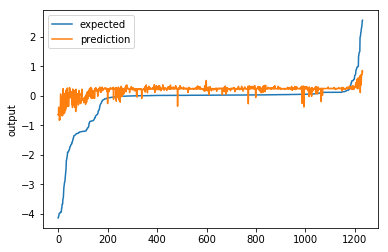

In [0]:
pred = model.predict(x_test)

avg=sum(pred) / len(pred)
print("pred mean:{}".format(pred.mean()))
print("target mean :{}".format(y_test.mean()))
print('absolute difference of pred and target mean :{}'.format(np.absolute(pred.mean()-y_test.mean())))

score = np.sqrt(metrics.mean_squared_error(pred,y_test))
print("(RMSE): {}".format(score))

chart_regression(pred.flatten(),y_test)

(1232,)
(1232,)


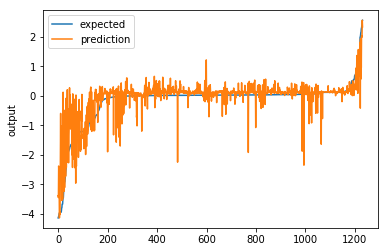

pred mean:-0.04593898395647605
target mean :-0.15178495710547066
absolute difference of pred and target mean :0.1058459731489946
(RMSE): 0.46403479896126837


In [0]:


#chart_regression(pred.flatten(),y_test)
pred=(np.reshape(pred, [pred.shape[0],]))
print(np.shape(pred))
print(np.shape(y_test))
c=-4.14
d=2.57
f= interp1d([np.min(pred),np.max(pred)],[c,d])
pred = f(pred)


l= interp1d([np.min(y_test),np.max(y_test)],[c,d])
y_test = l(y_test)
chart_regression(pred,y_test)

avg=sum(pred) / len(pred)
print("pred mean:{}".format(pred.mean()))
print("target mean :{}".format(y_test.mean()))
print('absolute difference of pred and target mean :{}'.format(np.absolute(pred.mean()-y_test.mean())))

score = np.sqrt(metrics.mean_squared_error(pred,y_test))
print("(RMSE): {}".format(score))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  if __name__ == '__main__':


[[0.12127814]]
time taken to predict:  0.021250009536743164


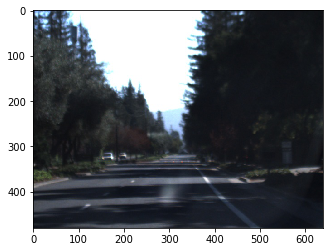

FPS: 47.058802409990015
[[0.04311476]]
time taken to predict:  0.024285078048706055


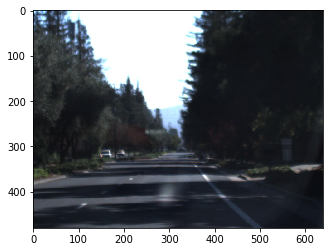

FPS: 41.177549357445095
[[0.19259775]]
time taken to predict:  0.022312402725219727


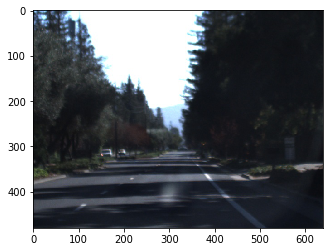

FPS: 44.81812256237645
[[0.03339876]]
time taken to predict:  0.03441786766052246


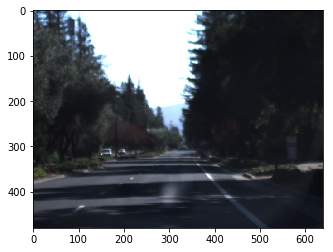

FPS: 29.0546761892227
[[0.46289676]]
time taken to predict:  0.02995777130126953


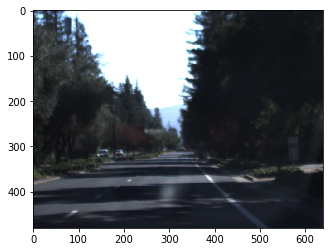

FPS: 33.3803202495782
[[0.37021053]]
time taken to predict:  0.021387815475463867


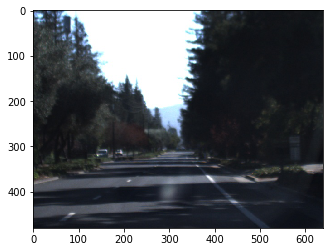

FPS: 46.75559320900264
[[0.647838]]
time taken to predict:  0.02869129180908203


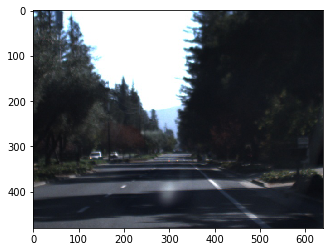

FPS: 34.85378095396377
[[0.68279326]]
time taken to predict:  0.03156876564025879


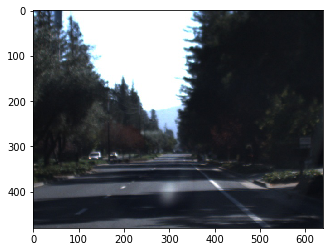

FPS: 31.67687997039476
[[0.501716]]
time taken to predict:  0.020526647567749023


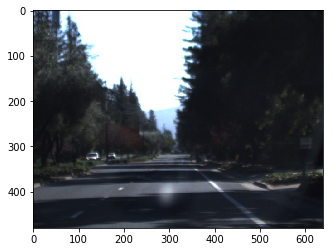

FPS: 48.717161275335386
[[0.49319735]]
time taken to predict:  0.022634506225585938


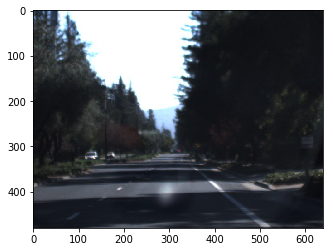

FPS: 44.1803320131457
[[0.4500742]]
time taken to predict:  0.02213430404663086


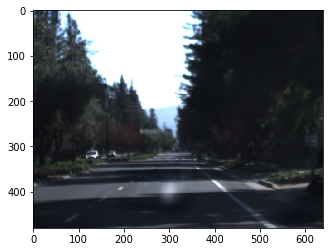

FPS: 45.17874146362481
[[0.3601856]]
time taken to predict:  0.022414445877075195


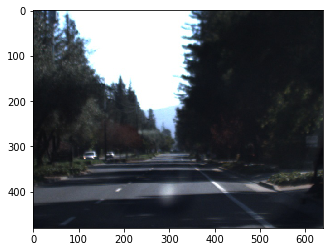

FPS: 44.614085286077454
[[0.30027467]]
time taken to predict:  0.018438339233398438


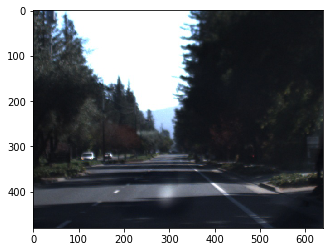

FPS: 54.23481948898314
[[0.38066047]]
time taken to predict:  0.01853203773498535


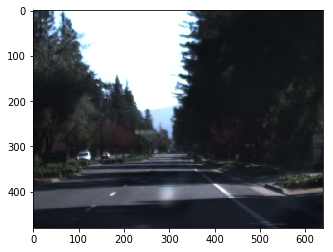

FPS: 53.96060672335936
[[0.3872383]]
time taken to predict:  0.01830315589904785


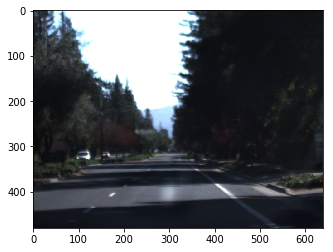

FPS: 54.63538667951908
[[0.77705616]]
time taken to predict:  0.017796754837036133


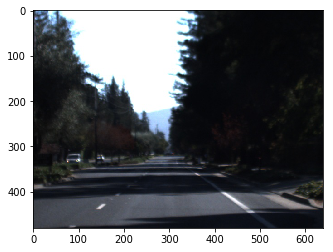

FPS: 56.19001942527966
[[0.44898945]]
time taken to predict:  0.018285512924194336


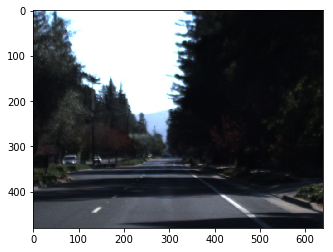

FPS: 54.68810222309147
[[0.20410457]]
time taken to predict:  0.034630775451660156


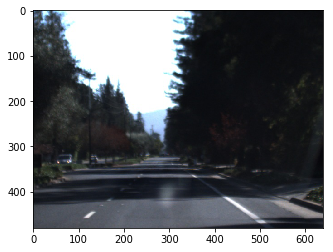

FPS: 28.876049899485032
[[0.19590089]]
time taken to predict:  0.03604245185852051


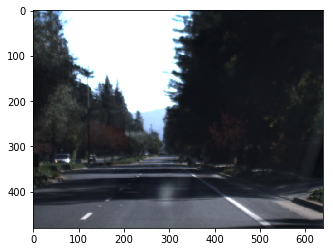

FPS: 27.745060295158527
[[0.8651725]]
time taken to predict:  0.035413503646850586


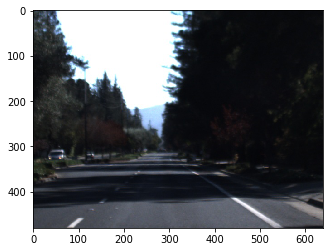

FPS: 28.237816002962266
[[0.851268]]
time taken to predict:  0.0323028564453125


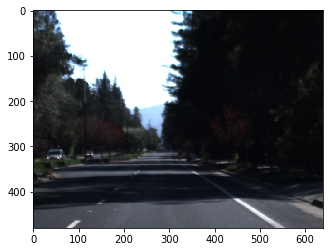

FPS: 30.95701464336325
[[0.81201166]]
time taken to predict:  0.023316144943237305


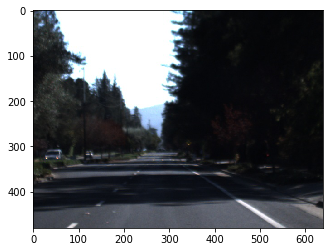

FPS: 42.888736642977655
[[-0.3343163]]
time taken to predict:  0.029269933700561523


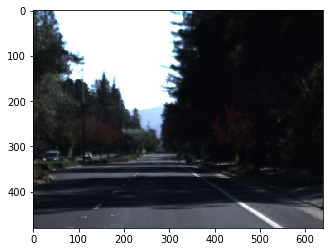

FPS: 34.16475111389869
[[-0.7682514]]
time taken to predict:  0.038376569747924805


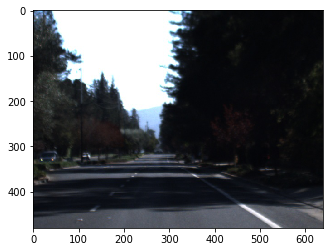

FPS: 26.0575660244901
[[0.29485527]]
time taken to predict:  0.030567407608032227


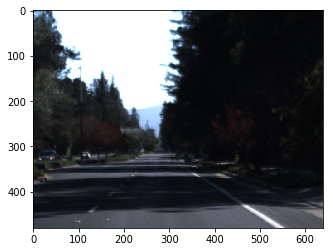

FPS: 32.71458321958677
[[0.53014445]]
time taken to predict:  0.02474045753479004


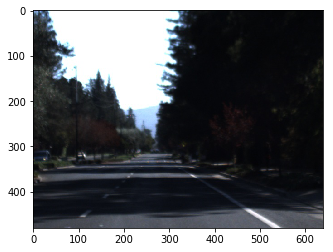

FPS: 40.419624357948905
[[0.6595548]]
time taken to predict:  0.03185129165649414


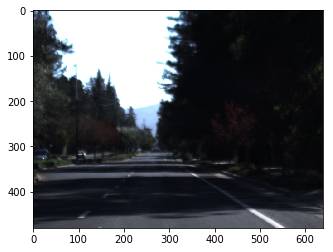

FPS: 31.39590101351857
[[0.6477885]]
time taken to predict:  0.03876304626464844


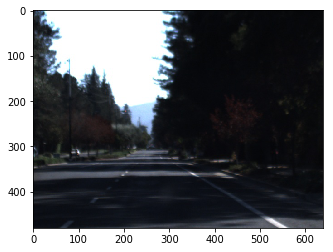

FPS: 25.797766077842837
[[0.60016423]]
time taken to predict:  0.020999908447265625


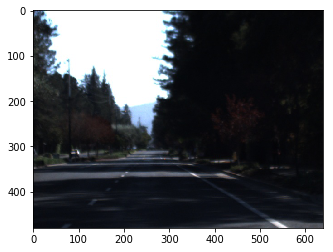

FPS: 47.61925522252498
[[0.6912363]]
time taken to predict:  0.021529674530029297


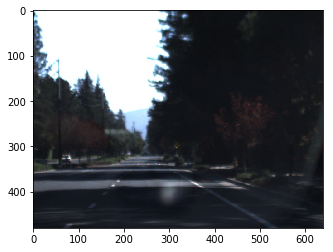

FPS: 46.44752054218068
[[0.657272]]
time taken to predict:  0.021550893783569336


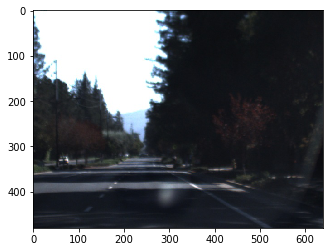

FPS: 46.40178778860727
[[0.64301956]]
time taken to predict:  0.026258468627929688


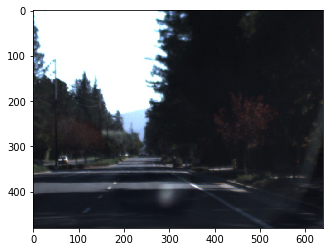

FPS: 38.082951986634704
[[0.76506865]]
time taken to predict:  0.023988008499145508


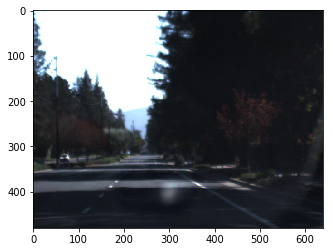

FPS: 41.687495651655354
[[0.6672912]]
time taken to predict:  0.02268242835998535


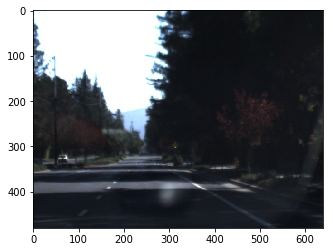

FPS: 44.086990340246174
[[0.71549356]]
time taken to predict:  0.021424293518066406


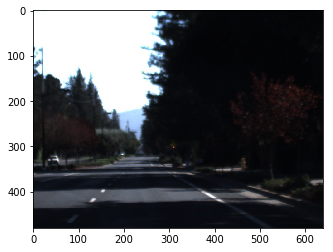

FPS: 46.675984865346095
[[0.7582942]]
time taken to predict:  0.021175622940063477


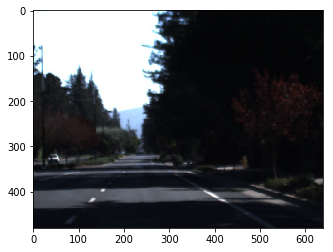

FPS: 47.22411250098517
[[0.34134278]]
time taken to predict:  0.029145002365112305


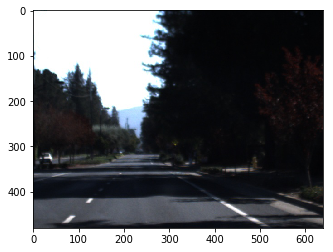

FPS: 34.311199823302765
[[0.33568704]]
time taken to predict:  0.026775836944580078


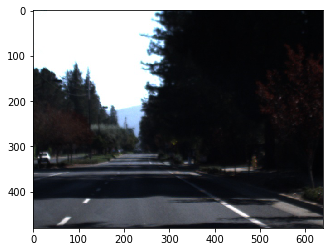

FPS: 37.34710523035279
[[0.01578884]]
time taken to predict:  0.016193389892578125


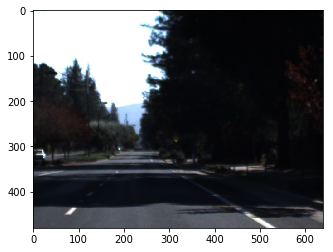

FPS: 61.75359246171967
[[0.14327694]]
time taken to predict:  0.026228666305541992


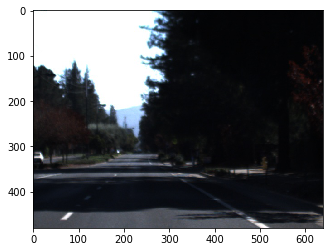

FPS: 38.12622374126224
[[0.5003037]]
time taken to predict:  0.02458667755126953


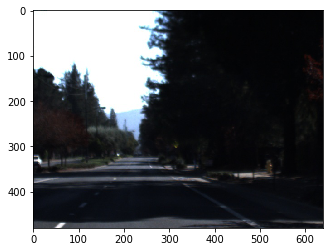

FPS: 40.67243318723091
[[0.5824353]]
time taken to predict:  0.021584510803222656


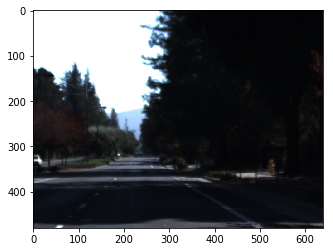

FPS: 46.3295188441656
[[0.4778066]]
time taken to predict:  0.026228666305541992


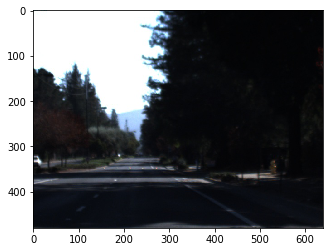

FPS: 38.12622374126224
[[0.5157012]]
time taken to predict:  0.01880788803100586


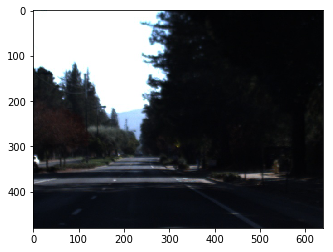

FPS: 53.169180843242145
[[0.5572715]]
time taken to predict:  0.021574974060058594


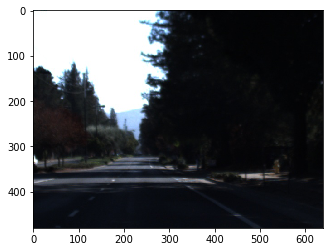

FPS: 46.34999778985988
[[0.6252284]]
time taken to predict:  0.03470158576965332


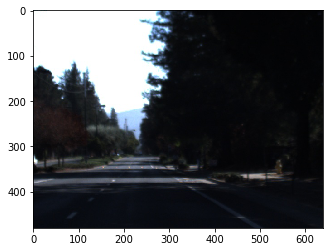

FPS: 28.81712687823345
[[0.6687906]]
time taken to predict:  0.02717900276184082


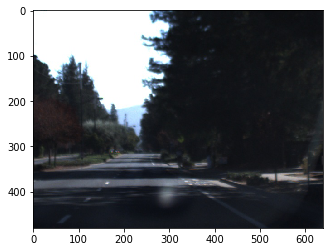

FPS: 36.79310859057694
[[-0.96868896]]
time taken to predict:  0.03738045692443848


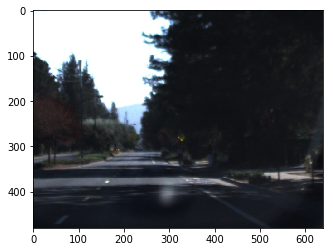

FPS: 26.751946933699013
[[-0.9554996]]
time taken to predict:  0.02424311637878418


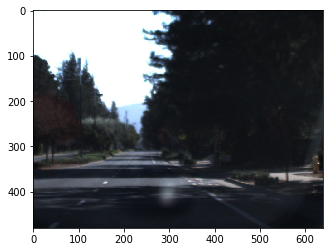

FPS: 41.24882232034854
[[-0.9512349]]
time taken to predict:  0.022133827209472656


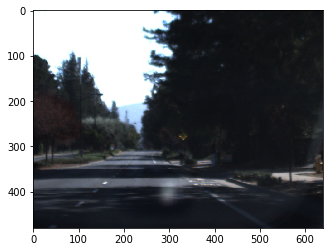

FPS: 45.179714765823604
[[0.80443627]]
time taken to predict:  0.026547908782958984


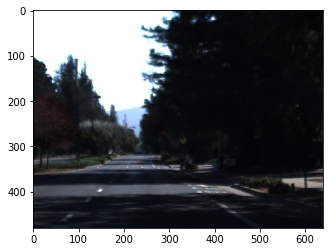

FPS: 37.66775033677593
[[0.79190135]]
time taken to predict:  0.04147624969482422


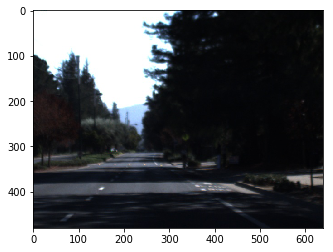

FPS: 24.11018371617116
[[0.7448794]]
time taken to predict:  0.031182289123535156


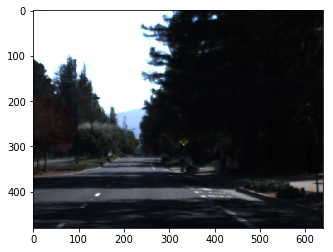

FPS: 32.06948649723216
[[0.81081927]]
time taken to predict:  0.042563438415527344


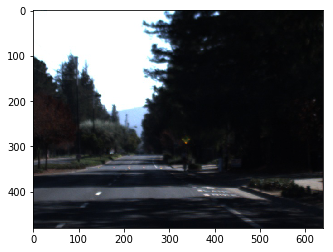

FPS: 23.494342497367303
[[0.77063245]]
time taken to predict:  0.03822207450866699


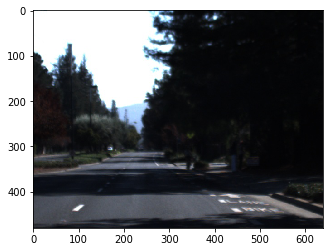

FPS: 26.16289180675545
[[0.61784554]]
time taken to predict:  0.023093461990356445


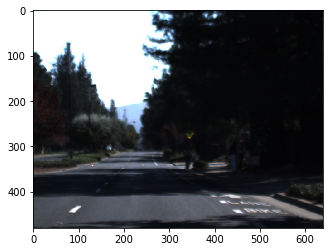

FPS: 43.302299170976966
[[0.431684]]
time taken to predict:  0.03137350082397461


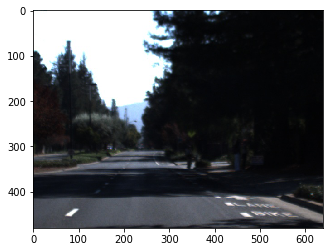

FPS: 31.874032981229576
[[0.44995216]]
time taken to predict:  0.026288986206054688


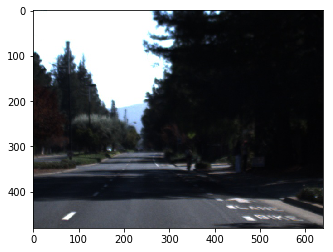

FPS: 38.0387433795255
[[0.45854995]]
time taken to predict:  0.033170461654663086


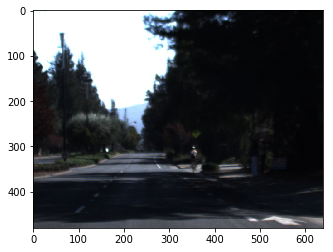

FPS: 30.147304261573957
[[0.13603374]]
time taken to predict:  0.03631162643432617


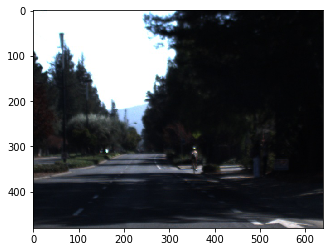

FPS: 27.539388845845753
[[0.3763518]]
time taken to predict:  0.03151988983154297


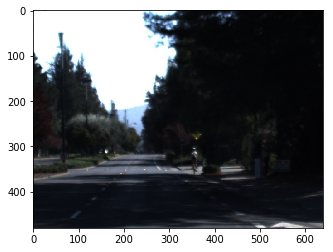

FPS: 31.725999213336966
[[0.21449527]]
time taken to predict:  0.031109333038330078


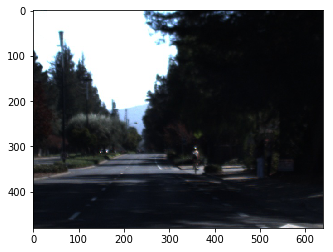

FPS: 32.14469428733465
[[0.32923463]]
time taken to predict:  0.03087329864501953


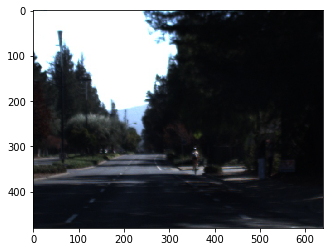

FPS: 32.39044883081581
[[0.75385875]]
time taken to predict:  0.027773141860961914


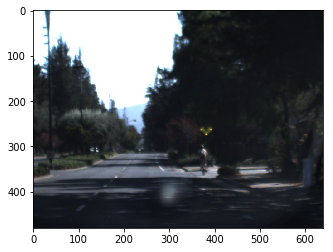

FPS: 36.00600915107864
[[0.69158053]]
time taken to predict:  0.03180098533630371


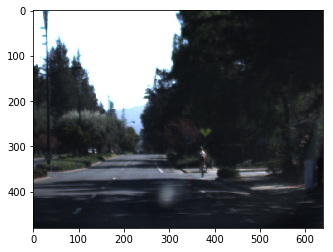

FPS: 31.44556652646889
[[0.45996612]]
time taken to predict:  0.03307390213012695


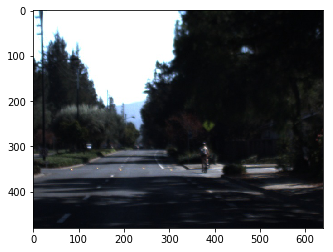

FPS: 30.235319559983274
[[0.60344684]]
time taken to predict:  0.021805286407470703


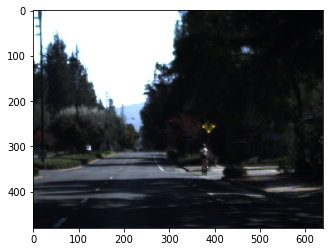

FPS: 45.860438671302674
[[0.7569879]]
time taken to predict:  0.03215837478637695


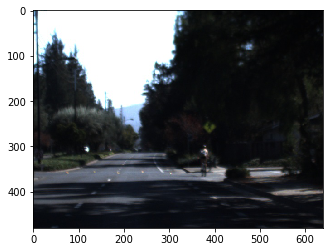

FPS: 31.096098812295192
[[0.6486155]]
time taken to predict:  0.036087751388549805


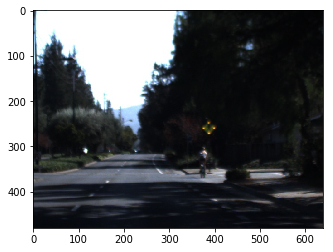

FPS: 27.71023301599466
[[0.68909216]]
time taken to predict:  0.02123427391052246


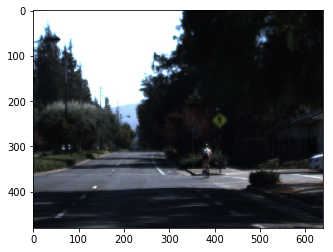

FPS: 47.09367526357747
[[0.55735815]]
time taken to predict:  0.029485464096069336


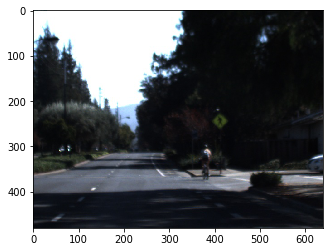

FPS: 33.91501645494902
[[0.86238384]]
time taken to predict:  0.021218299865722656


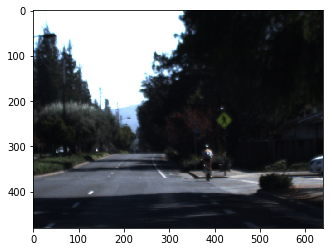

FPS: 47.12912939907412
[[0.76365113]]
time taken to predict:  0.020592689514160156


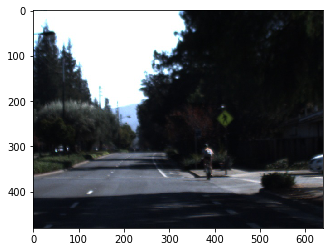

FPS: 48.56092252118742
[[0.81109315]]
time taken to predict:  0.02692699432373047


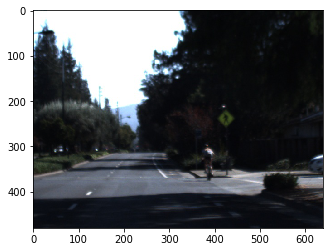

FPS: 37.137453515140784
[[0.7851398]]
time taken to predict:  0.03947806358337402


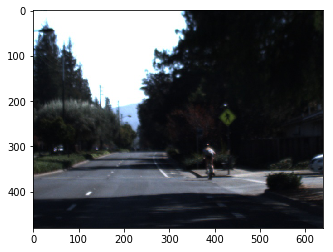

FPS: 25.330523060942248
[[-0.9999952]]
time taken to predict:  0.04215884208679199


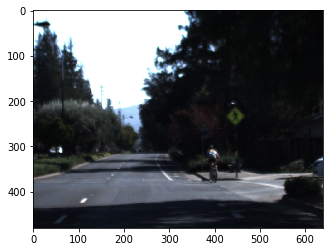

FPS: 23.719816543853597
[[-0.9454854]]
time taken to predict:  0.032372474670410156


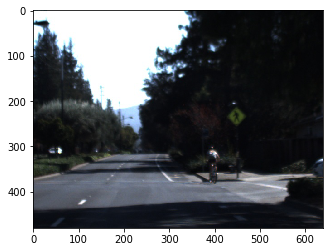

FPS: 30.89044041832376
[[-1.]]
time taken to predict:  0.028150081634521484


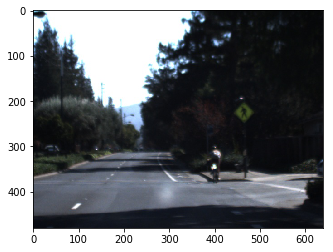

FPS: 35.52387566697722
[[-1.]]
time taken to predict:  0.03545737266540527


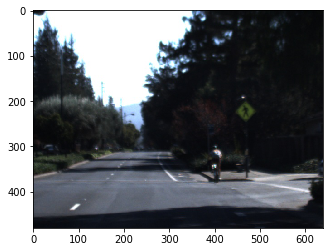

FPS: 28.202879255508712
[[-1.]]
time taken to predict:  0.040952444076538086


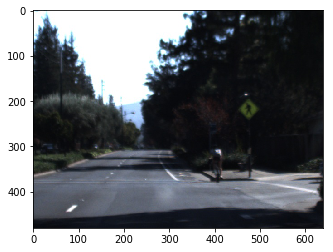

FPS: 24.418567012289905
[[-1.]]
time taken to predict:  0.03390002250671387


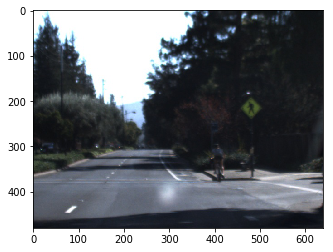

FPS: 29.49850548925007
[[0.91119206]]
time taken to predict:  0.028478145599365234


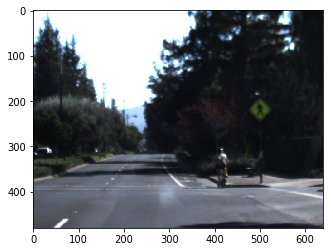

FPS: 35.11464594879695
[[-0.91786367]]
time taken to predict:  0.022981882095336914


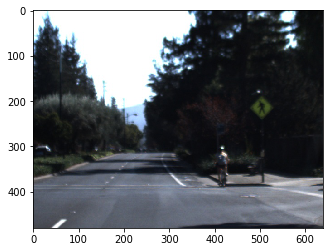

FPS: 43.5125372174328
[[0.69954056]]
time taken to predict:  0.028481721878051758


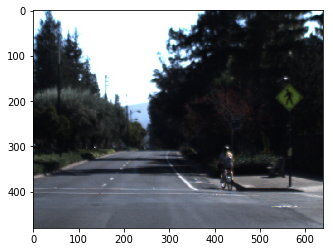

FPS: 35.11023681368815
[[0.8779191]]
time taken to predict:  0.03125476837158203


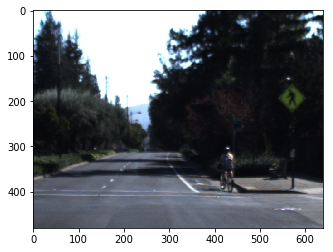

FPS: 31.99511793244439
[[0.98918843]]
time taken to predict:  0.03227066993713379


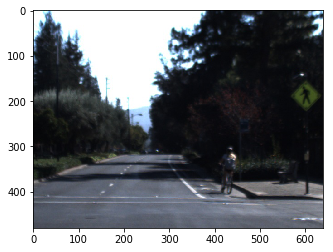

FPS: 30.98789092225514
[[0.98916453]]
time taken to predict:  0.03182220458984375


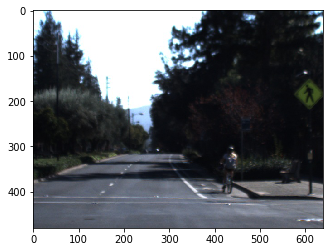

FPS: 31.424598417645647
[[0.98676896]]
time taken to predict:  0.03140544891357422


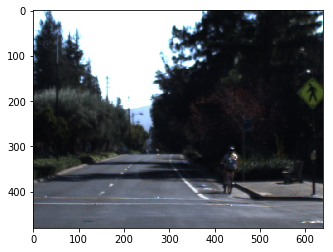

FPS: 31.841608211108074
[[0.9307411]]
time taken to predict:  0.0260772705078125


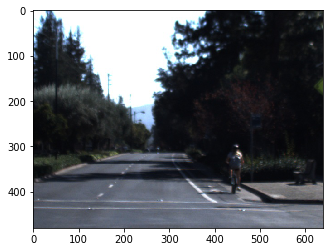

FPS: 38.34757167934465
[[0.9163313]]
time taken to predict:  0.02087998390197754


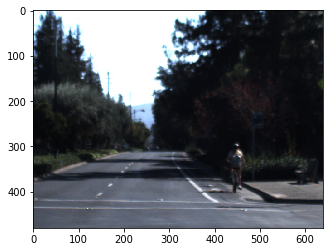

FPS: 47.89275723077977
[[0.82388186]]
time taken to predict:  0.022123336791992188


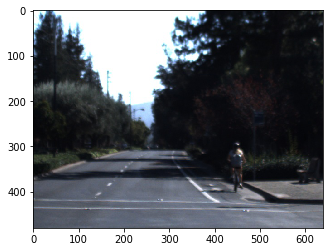

FPS: 45.201138029140445
[[0.6804637]]
time taken to predict:  0.025791168212890625


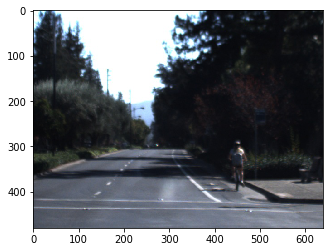

FPS: 38.772962579500074
[[0.76234835]]
time taken to predict:  0.02553534507751465


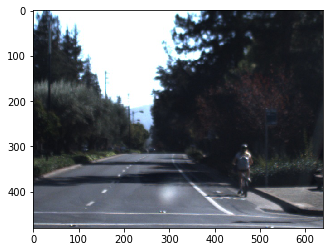

FPS: 39.16140537613325
[[0.8068999]]
time taken to predict:  0.026453733444213867


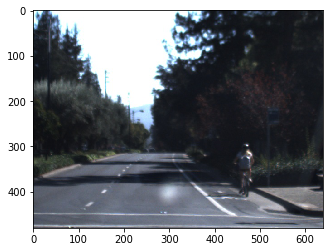

FPS: 37.801847595872204
[[0.9960371]]
time taken to predict:  0.03430795669555664


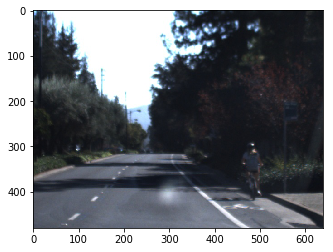

FPS: 29.14775743929728
[[0.9948063]]
time taken to predict:  0.016844749450683594


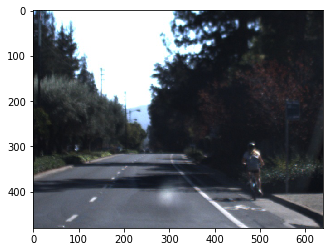

FPS: 59.36567966936534
[[0.9879314]]
time taken to predict:  0.023702383041381836


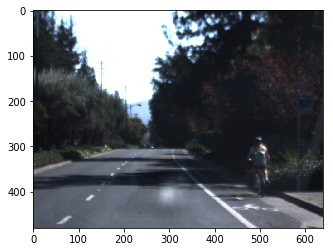

FPS: 42.18985062616306
[[0.99536693]]
time taken to predict:  0.024855852127075195


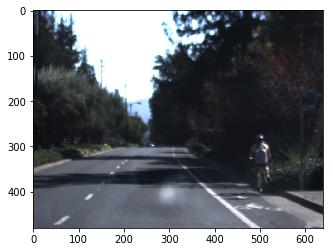

FPS: 40.23197413983291
[[0.9918795]]
time taken to predict:  0.02600383758544922


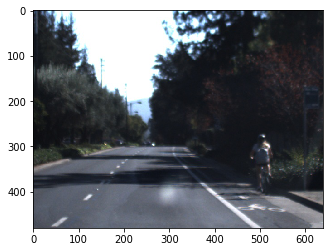

FPS: 38.4558623977702
[[0.99373186]]
time taken to predict:  0.0206911563873291


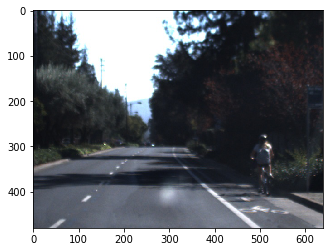

FPS: 48.32982658293484
[[0.99686503]]
time taken to predict:  0.03201770782470703


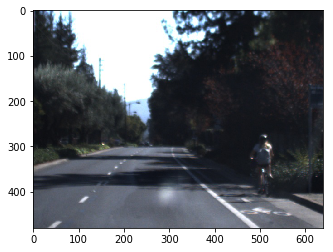

FPS: 31.23271676644923
[[0.9949948]]
time taken to predict:  0.02089715003967285


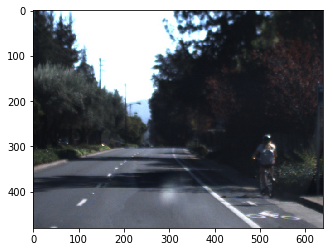

FPS: 47.853415327043095
[[-0.9749382]]
time taken to predict:  0.03170490264892578


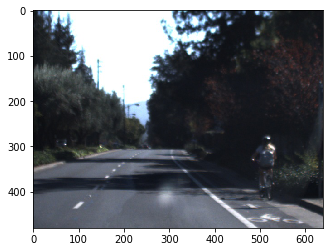

FPS: 31.540863287712437
[[-0.859435]]
time taken to predict:  0.026415348052978516


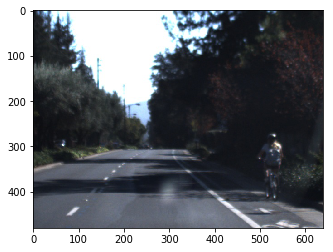

FPS: 37.85677924797372
[[-0.7431562]]
time taken to predict:  0.026875019073486328


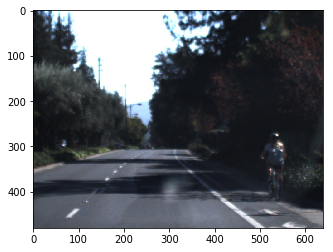

FPS: 37.20927591774454
[[-1.]]
time taken to predict:  0.022186279296875


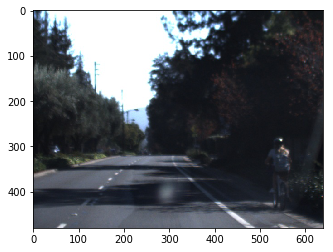

FPS: 45.07290233837689
[[-1.]]
time taken to predict:  0.028349637985229492


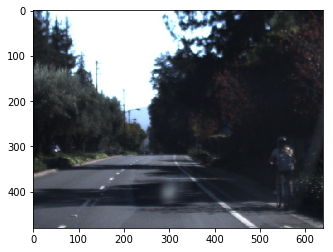

FPS: 35.27381903504419
[[-0.9629859]]
time taken to predict:  0.020919322967529297


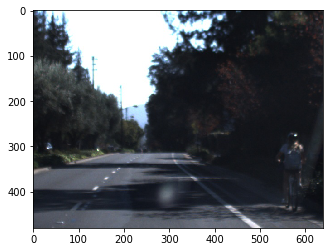

FPS: 47.802694262724806
[[-1.]]
time taken to predict:  0.02702188491821289


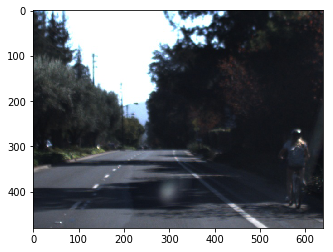

FPS: 37.00704088655173
[[0.93053436]]
time taken to predict:  0.025015592575073242


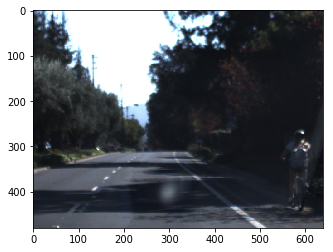

FPS: 39.97506743040134
[[-1.]]
time taken to predict:  0.020069599151611328


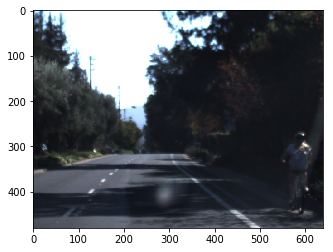

FPS: 49.82660552638457
[[-1.]]
time taken to predict:  0.019169092178344727


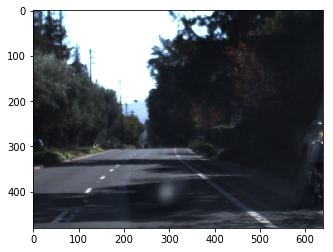

FPS: 52.16731135184886
[[-1.]]
time taken to predict:  0.02503681182861328


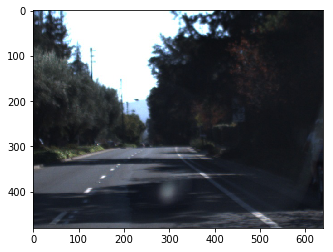

FPS: 39.94118767378966
[[0.6833363]]
time taken to predict:  0.02767491340637207


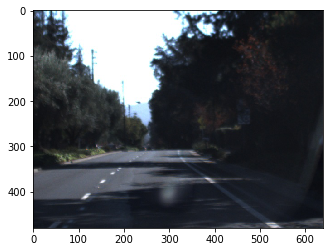

FPS: 36.13380773107506
[[0.83679026]]
time taken to predict:  0.019588708877563477


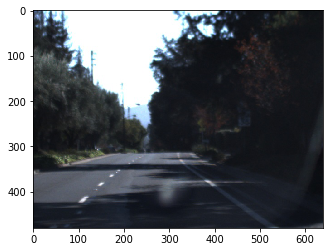

FPS: 51.049816823066905
[[0.8797105]]
time taken to predict:  0.019442081451416016


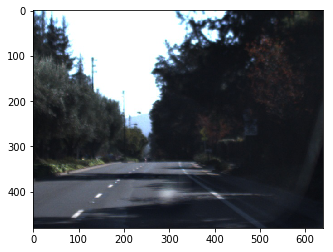

FPS: 51.43482206362053
[[0.7417533]]
time taken to predict:  0.019260168075561523


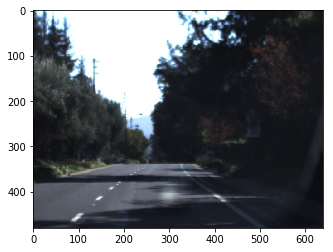

FPS: 51.92062686456309
[[0.12481056]]
time taken to predict:  0.019976377487182617


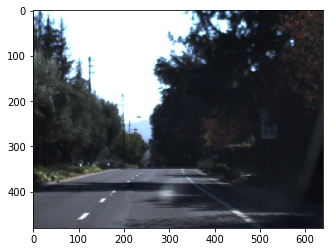

FPS: 50.05912611741678
[[0.05514216]]
time taken to predict:  0.020205259323120117


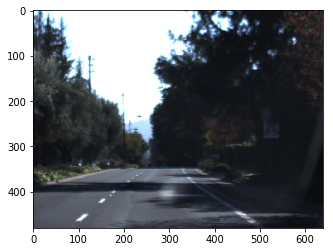

FPS: 49.492064615856606
[[0.18000662]]
time taken to predict:  0.01964426040649414


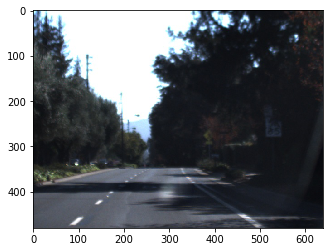

FPS: 50.905454280651504
[[0.24167858]]
time taken to predict:  0.0199434757232666


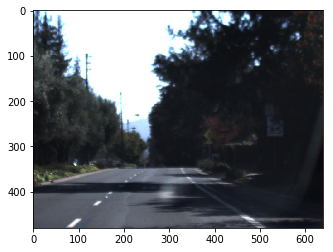

FPS: 50.14171119798205
[[0.50574356]]
time taken to predict:  0.02049398422241211


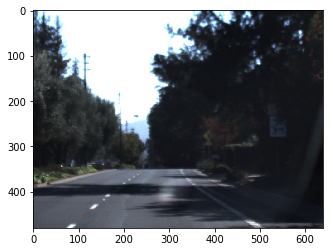

FPS: 48.79480676609507
[[0.38954467]]
time taken to predict:  0.020159006118774414


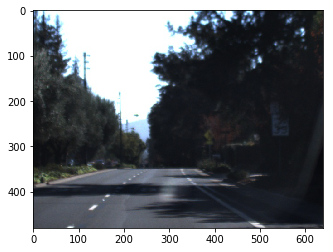

FPS: 49.605620143578584
[[0.5218606]]
time taken to predict:  0.020886898040771484


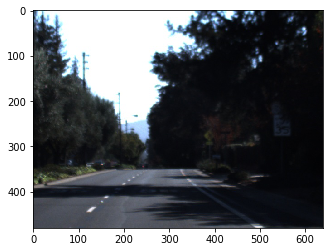

FPS: 47.876903408442345
[[0.9563971]]
time taken to predict:  0.01941227912902832


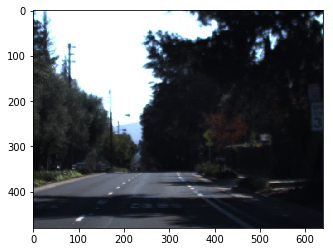

FPS: 51.513786369609804
[[0.94034415]]
time taken to predict:  0.019368648529052734


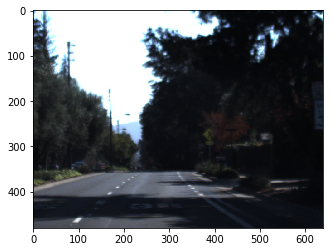

FPS: 51.62982840542603
[[0.83234924]]
time taken to predict:  0.02004718780517578


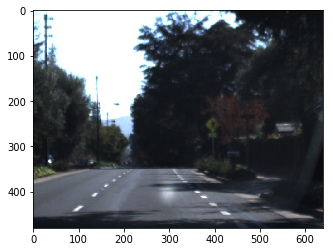

FPS: 49.882308168022455
[[0.8602518]]
time taken to predict:  0.02094578742980957


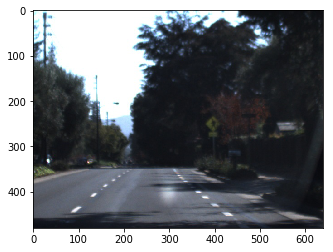

FPS: 47.74229679123081
[[0.86499995]]
time taken to predict:  0.018465518951416016


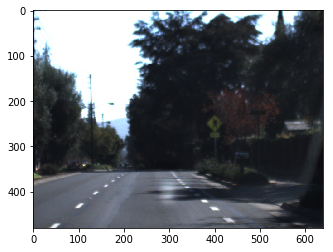

FPS: 54.15499031633312
[[0.86570275]]
time taken to predict:  0.02934885025024414


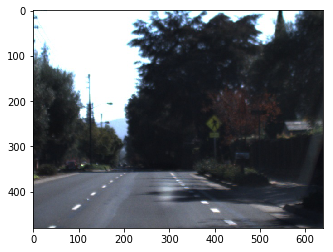

FPS: 34.072885018440594
[[0.81013507]]
time taken to predict:  0.019947290420532227


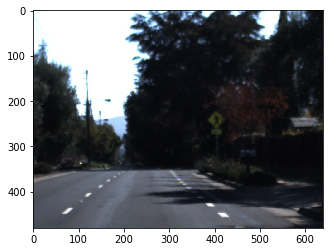

FPS: 50.132122153827765
[[0.7831907]]
time taken to predict:  0.02022385597229004


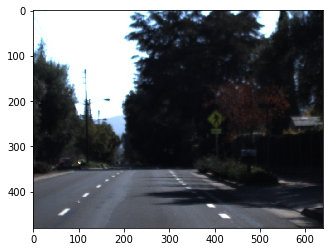

FPS: 49.44655467138226
[[0.8828687]]
time taken to predict:  0.01965045928955078


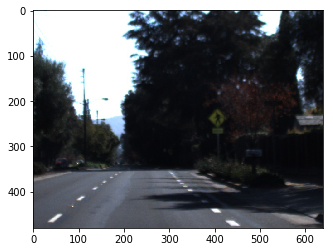

FPS: 50.889395777723855
[[0.8983934]]
time taken to predict:  0.02050614356994629


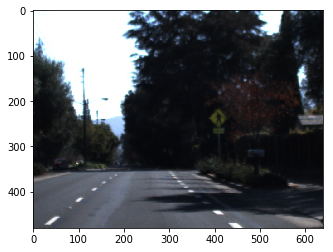

FPS: 48.765873338836634
[[0.8994983]]
time taken to predict:  0.021020174026489258


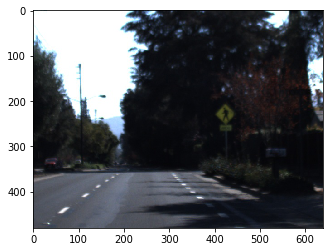

FPS: 47.573345431860716
[[0.9218661]]
time taken to predict:  0.020089149475097656


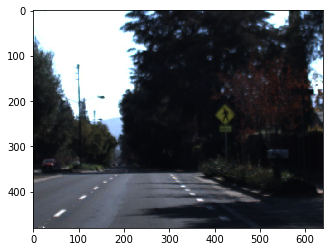

FPS: 49.77811535722763
[[0.97514975]]
time taken to predict:  0.02904200553894043


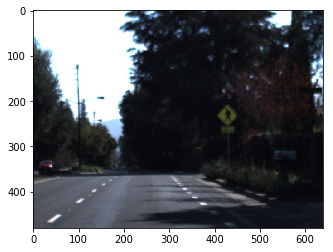

FPS: 34.43288372971242
[[0.98071176]]
time taken to predict:  0.02368474006652832


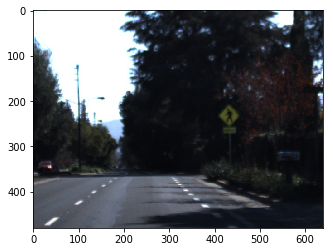

FPS: 42.22127822349282
[[0.98662317]]
time taken to predict:  0.026568174362182617


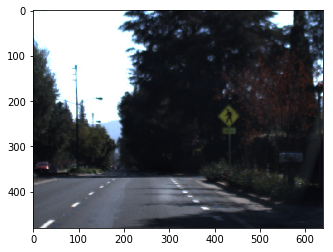

FPS: 37.63901826176695
[[0.9710532]]
time taken to predict:  0.03525996208190918


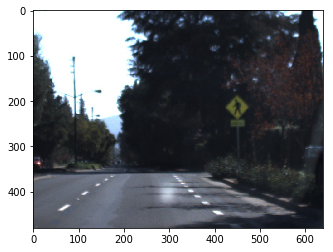

FPS: 28.360779222535516
[[0.9797373]]
time taken to predict:  0.022812366485595703


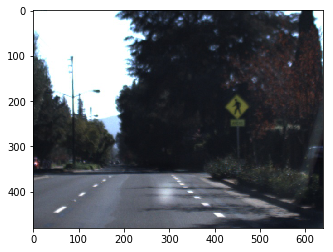

FPS: 43.8358729959658
[[0.9785217]]
time taken to predict:  0.03200984001159668


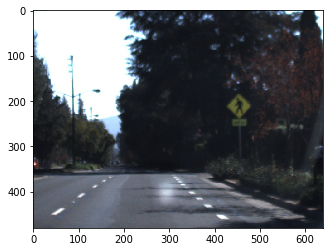

FPS: 31.240393567656543
[[0.9693507]]
time taken to predict:  0.033629417419433594


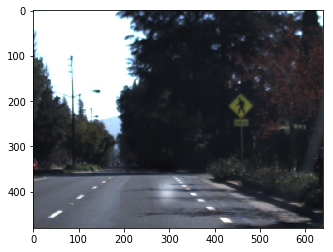

FPS: 29.735870459121458
[[0.9760853]]
time taken to predict:  0.029050827026367188


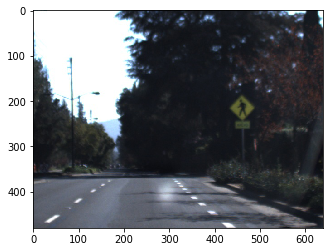

FPS: 34.422427943010966
[[0.9848246]]
time taken to predict:  0.03312492370605469


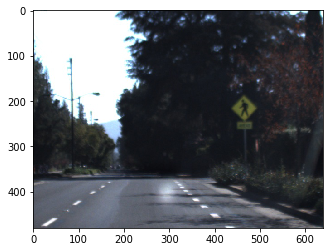

FPS: 30.18874877641504
[[0.966999]]
time taken to predict:  0.030282258987426758


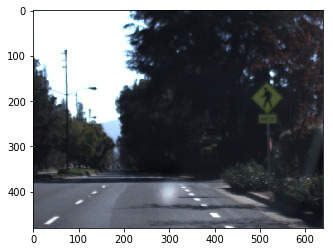

FPS: 33.02263547825813
[[0.9572362]]
time taken to predict:  0.02843928337097168


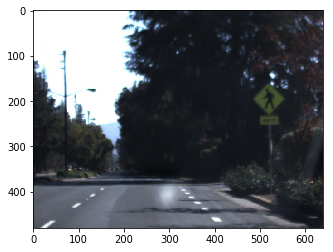

FPS: 35.16263004786935
[[0.9680916]]
time taken to predict:  0.02773308753967285


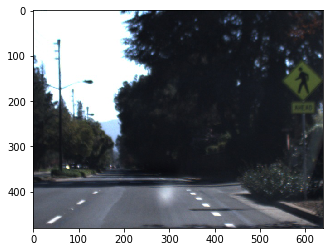

FPS: 36.05801188091574
[[0.97251505]]
time taken to predict:  0.025501489639282227


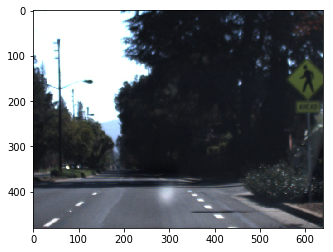

FPS: 39.213395536690946
[[0.9124528]]
time taken to predict:  0.020738840103149414


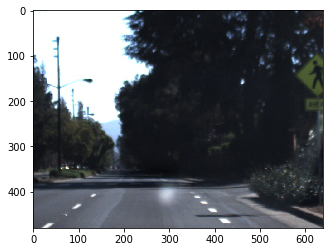

FPS: 48.21870437431741
[[0.94729733]]
time taken to predict:  0.020787477493286133


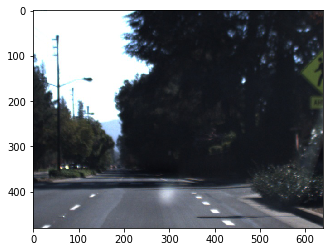

FPS: 48.105884916675265
[[0.9334513]]
time taken to predict:  0.02204275131225586


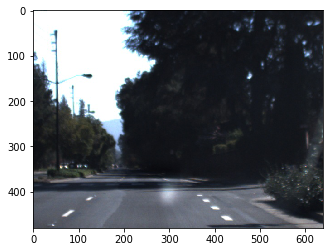

FPS: 45.36638760897311
[[0.7814303]]
time taken to predict:  0.02230048179626465


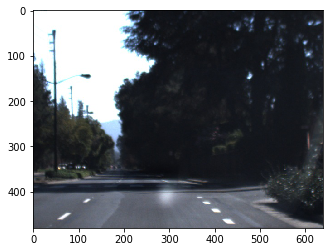

FPS: 44.84208050462394
[[0.80292535]]
time taken to predict:  0.03068709373474121


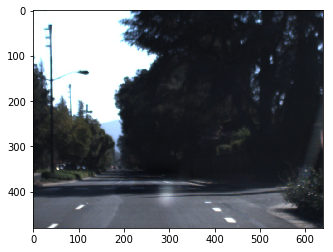

FPS: 32.58698945700057
[[0.74271345]]
time taken to predict:  0.031812191009521484


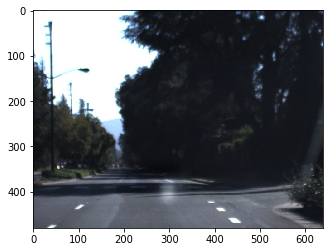

FPS: 31.434489994753804
[[0.7549552]]
time taken to predict:  0.021603822708129883


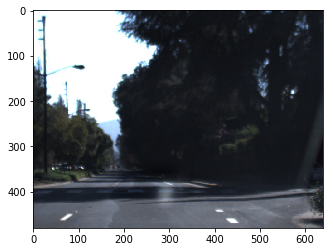

FPS: 46.28810435588712
[[0.8446592]]
time taken to predict:  0.024661779403686523


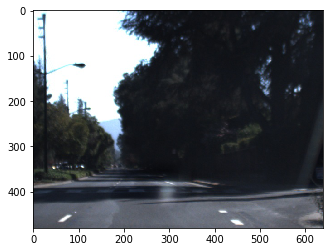

FPS: 40.54857452218216
[[0.90405655]]
time taken to predict:  0.021203994750976562


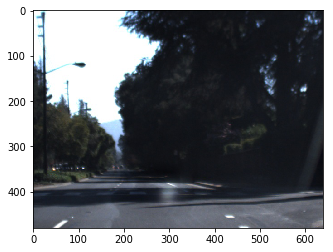

FPS: 47.16092470990375
[[0.92978036]]
time taken to predict:  0.021538734436035156


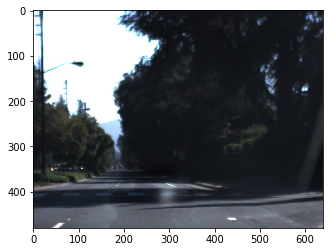

FPS: 46.42798317467346
[[0.43928143]]
time taken to predict:  0.03170609474182129


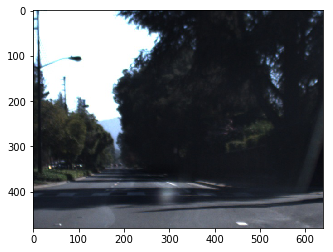

FPS: 31.539677407226378


In [0]:
import time
m=66
n=200


for i in range(0,len(alldf)-6000):
  start=time.time()
  image_name=os.path.join(base_path, 'center_frames', alldf.iloc[i][0])
  img= scipy.misc.imread(image_name)
  crop_img = img[240:480, 0:640]
  resized_img = cv2.resize(crop_img, (n,m), interpolation=cv2.INTER_AREA)
  
  resized_img = resized_img.reshape(1, 66, 200, 3)
  pred = model.predict(resized_img)
  end = time.time()
  print(pred)
  print('time taken to predict: ',end-start)
  
  #print('error is: ',abs(pred-steering_ang[i]))
  
  plt.imshow(img)
  plt.show()
  
  fps=1/(end-start)
  print('FPS:', fps)
  
  
  

In [0]:
print(np.shape(y_test))
print(np.shape(y_train))

(1232,)
(4928, 1)
